In [1]:
import mols2grid
import pandas as pd

df = pd.read_csv('../../rawDSSCDBdata.csv')
df['Solar simulator']
df.groupby(['Electrolyte']).count().sort_values('PCE', ascending=False)

#create standard string form for all versions to adhere to
#take care of each condtional --> list vs string --> each type of entry formatt
    


,VOC,JSC,FF,PCE,Active area,Co-adsorbent,Co-sensitizer,Semiconductor,Dye loading,Exposure time,...,Article EID,Article year,Article year.1,Article electronic id,Article keywords,Molecule SMILE,Molecule keywords,Molecule spectrum absorption maxima,Molecule spectrum emission maxima,Molecule spectrum solvent
Electrolyte,,,,,,,,,,,,,,,,,,,,,
iodide/triiodide,88,88,88,88,88,88,88,88,88,88,...,0,88,88,0,0,88,88,79,21,88
"LiI (500 mM), iodine (50 mM), 4-tBu pyridine (580 mM) and ethyl-methyl-imidazolium dicyanoimide (600 mM) in MeCN",54,54,54,54,54,54,54,54,54,54,...,0,54,54,0,0,54,54,54,0,54
"0.05 M I2, 0.5 M LiI, 0.5 M tert-butylpyridine in acetonitrile",39,39,39,39,39,39,39,39,39,39,...,0,39,39,0,0,39,39,34,29,39
HPE electrolyte (triiodide/iodide),36,36,36,36,36,29,36,36,36,36,...,0,36,36,0,0,36,36,34,32,36
"0.5 M lithium iodide (LiI), 0.05 M iodine (I2), and 0.5 M 4-tert-butylpyridine in acetonitrile",32,32,32,32,32,32,32,32,32,32,...,0,32,32,0,0,32,32,28,8,32
"LiI (100 mM), iodine (30 mM), 4-tert-butyl pyridine (500 mM) and 1-butyl-3-methyl-imidazolium iodide (600 mM) in mixed solvent of acetonitrile and varelonitrile (volume ratio of 85:15)",31,31,31,31,31,31,31,31,31,31,...,0,31,31,0,0,31,31,29,0,31
"0.1 M LiI, 0.03 M I2, 0.6 M 1-methyl-3-propylimidazolium iodide, and 0.5 M tert-butylpyridine in dry acetonitrile",29,29,29,29,29,29,29,29,29,29,...,0,29,29,0,0,29,29,28,0,29
"0.5 M LiI, 0.01 M I2, 0.6 M dimethylpropyl imidazolium iodide, and 0.5 M 4-t-butylpyridine in acetonitrile",28,28,28,28,28,28,28,28,28,28,...,0,28,28,0,0,28,28,25,25,28
"0.8 M 1-methyl-3-propyl imidazolium iodide (PMII), 0.1 M lithium iodide (LiI), 0.05 M iodine (I2), and 0.5 M 4-tert-butylpyridine dissolved in acetonitrile",25,25,25,25,25,25,25,25,25,25,...,0,25,25,0,0,25,25,18,0,25


In [7]:
#retrieve instances with no Co-adsorbants, no Co-sensitizers, TiO2 Semiconductor

# dfFirstFilter = df.loc[(df['Co-adsorbent']=="-") & (df['Co-sensitizer']=="-") & (df['Semiconductor'].str.contains('TiO2'))]
# dfFirstFilter['Electrolyte']

# Standardizing Solar Simulator Settings
# First one won't work --> let's hope they can be retrieved together

# combining different styled entries example: Triphenylamine + triphenylamine --> triphenylamine

df['Molecule keywords'] = df['Molecule keywords'].str.lower()

dfFamilyFilter = df.loc[(df['Molecule keywords'].str.contains("triphenylamine"))
                        |(df['Molecule keywords'].str.contains("phenothiazine"))
                        |(df['Molecule keywords'].str.contains("carbazole"))
                        |(df['Molecule keywords'].str.contains("indoline"))
                        |(df['Molecule keywords'].str.contains("coumarin"))
                        |(df['Molecule keywords'].str.contains("diphenylamine"))
                        |(df['Molecule keywords'].str.contains("bodipy"))
                        |(df['Molecule keywords'].str.contains("imidazole"))
                        |(df['Molecule keywords'].str.contains("cyanine"))
                        ]

# language bias: simplifying family name of certain compounds
# Example: iminocoumarin --> coumarin
dfFamilyFilter.loc[(df['Molecule keywords']==varSolSim[index]), 'iminocoumarin'] = "coumarin"
dfFamilyFilter.loc[(df['Molecule keywords']==varSolSim[index]), 'indolocarbazole'] = "carbazole"
dfFamilyFilter.loc[(df['Molecule keywords']==varSolSim[index]), 'Solar simulator'] = "AM 1.5G 100mW/cm2"
dfFamilyFilter.loc[(df['Molecule keywords']==varSolSim[index]), 'Solar simulator'] = "AM 1.5G 100mW/cm2"
dfFamilyFilter.loc[(df['Molecule keywords']==varSolSim[index]), 'Solar simulator'] = "AM 1.5G 100mW/cm2"


# Standardising Solar Simulator and Electrolyte entries

varSolSim = ["AM 1.5G 100 mW/cm2", 
             "AM 1.5",
             "AM 1.5 100 mW/cm2", 
             "AM 1.5 100mW/cm2", 
             "AM 1.5G 100mW/cm2",
             "AM 1.5G, 100 mW/cm2", 
             "AM 1.5G 100 mW/cm2", 
             "AM 1.5G, 100mW/cm2",
             "AM 1.5G", 
             "AM 1.5 100mW/cm2", 
             "AM 1.5G, 100 mw/cm2", 
             "AM 1.5 G",
             "AM1.5G, 100 mW/cm2", 
             "AM1.5 G 100 mW/cm2" 
             ,"AM1.5G"
            ]

varElectrolyte = ["iod", "Iod","LiI", "I2", "AN-I", "Mosalyte", "HI-30"]

for index in range(len(varSolSim)):
    dfFamilyFilter.loc[(df['Solar simulator']==varSolSim[index]), 'Solar simulator'] = "AM 1.5G 100mW/cm2"

for index in range(len(varElectrolyte)):
    dfFamilyFilter.loc[(df['Electrolyte'].str.contains(varElectrolyte[index])), 'Electrolyte'] = "Iodide_Triiodide"
    

dfPropFilter = dfFamilyFilter.loc[
                    (dfFamilyFilter['Co-adsorbent']=="-") # tested
                  & (dfFamilyFilter['Co-sensitizer']=="-") # tested
                  & (dfFamilyFilter['Semiconductor'].str.contains('TiO2')) # tested
                  & (~dfFamilyFilter['Molecule keywords'].str.contains(',')) # tested
                  & (dfFamilyFilter['Solar simulator'].str.contains('100')) # tested
                  & (dfFamilyFilter['Electrolyte']=="Iodide_Triiodide") # tested
                  & (~dfFamilyFilter['Molecule SMILE'].str.contains("se")) # tested
                 ] 

dfPropFilter.groupby('Solar simulator').count().sort_values('PCE', ascending=False)

dfPropFilter.groupby(['Molecule SMILE', 'PCE']).count().sort_values('PCE', ascending=False)

# taking max of duplicates

dfDropDupl = dfPropFilter.sort_values('PCE', ascending=False).drop_duplicates('Molecule SMILE').sort_index()

dfPropFilter.groupby(['Molecule keywords']).count().sort_values('PCE', ascending=False)

#dfDropDupl.loc[dfDropDupl['Molecule keywords']=="triphenylamine"].groupby(['Molecule SMILE']).mean().sort_values('PCE', ascending=False)


C:\Users\Paul\Anaconda3\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


,VOC,JSC,FF,PCE,Electrolyte,Active area,Co-adsorbent,Co-sensitizer,Semiconductor,Dye loading,...,Article issue nr,Article EID,Article year,Article year.1,Article electronic id,Article keywords,Molecule SMILE,Molecule spectrum absorption maxima,Molecule spectrum emission maxima,Molecule spectrum solvent
Molecule keywords,,,,,,,,,,,,,,,,,,,,,
triphenylamine,716,716,716,716,716,716,716,716,716,716,...,551,0,716,716,0,0,716,674,255,716
phenothiazine,280,280,280,280,280,280,280,280,280,280,...,191,0,280,280,0,0,280,269,112,280
carbazole,178,178,178,178,178,178,178,178,178,178,...,124,0,178,178,0,0,178,158,78,178
indoline,156,156,156,156,156,156,156,156,156,156,...,132,0,156,156,0,0,156,152,50,156
coumarin,79,79,79,79,79,79,79,79,79,79,...,62,0,79,79,0,0,79,79,53,79
diphenylamine,27,27,27,27,27,27,27,27,27,27,...,20,0,27,27,0,0,27,27,12,27
imidazole,12,12,12,12,12,12,12,12,12,12,...,6,0,12,12,0,0,12,12,6,12
cyanine,8,8,8,8,8,8,8,8,8,8,...,0,0,8,8,0,0,8,8,8,8
iminocoumarin,6,6,6,6,6,6,6,6,6,6,...,6,0,6,6,0,0,6,6,6,6


In [6]:
dfDropDupl.groupby(['Molecule keywords']).count().sort_values('PCE', ascending=False)



,VOC,JSC,FF,PCE,Electrolyte,Active area,Co-adsorbent,Co-sensitizer,Semiconductor,Dye loading,...,Article issue nr,Article EID,Article year,Article year.1,Article electronic id,Article keywords,Molecule SMILE,Molecule spectrum absorption maxima,Molecule spectrum emission maxima,Molecule spectrum solvent
Molecule keywords,,,,,,,,,,,,,,,,,,,,,
triphenylamine,554,554,554,554,554,554,554,554,554,554,...,431,0,554,554,0,0,554,523,191,554
phenothiazine,241,241,241,241,241,241,241,241,241,241,...,165,0,241,241,0,0,241,235,96,241
carbazole,141,141,141,141,141,141,141,141,141,141,...,97,0,141,141,0,0,141,134,67,141
indoline,111,111,111,111,111,111,111,111,111,111,...,94,0,111,111,0,0,111,108,25,111
coumarin,47,47,47,47,47,47,47,47,47,47,...,32,0,47,47,0,0,47,47,37,47
diphenylamine,27,27,27,27,27,27,27,27,27,27,...,20,0,27,27,0,0,27,27,12,27
imidazole,12,12,12,12,12,12,12,12,12,12,...,6,0,12,12,0,0,12,12,6,12
cyanine,8,8,8,8,8,8,8,8,8,8,...,0,0,8,8,0,0,8,8,8,8
iminocoumarin,6,6,6,6,6,6,6,6,6,6,...,6,0,6,6,0,0,6,6,6,6


In [2]:
globalDf = pd.read_csv('rawGlobalData.csv', index_col=0)
globalDf.head()#.groupby(['Molecule keywords']).count().sort_values('PCE', ascending=False)

,VOC,JSC,FF,PCE,Electrolyte,Active area,Co-adsorbent,Co-sensitizer,Semiconductor,Dye loading,...,Article EID,Article year,Article year.1,Article electronic id,Article keywords,Molecule SMILE,Molecule keywords,Molecule spectrum absorption maxima,Molecule spectrum emission maxima,Molecule spectrum solvent
0,687.0,10.79,0.70,5.19,Iodide_Triiodide,-,-,-,TiO2 (20 nm particle size),-,...,NaN,01/01/2012,Hong_2012,NaN,NaN,N#C/C(=C\c1ccc(cc1)N(c1ccccc1)CCCCCCN1c2ccccc2...,phenothiazine,439.0,576.0,CH2Cl2/MeOH (1:1)
10,560.0,3.41,0.73,1.39,Iodide_Triiodide,0.16,-,-,TiO2 film,-,...,NaN,01/01/2014,Han_2014,NaN,NaN,CCN([C@@H]1C=Cc2c(C1)oc(=O)c(c2)c1ccc(cc1)c1cc...,coumarin,465.0,490.0,Acetonitrile-DMSO
11,660.0,7.72,0.71,3.62,Iodide_Triiodide,0.16,-,-,TiO2 film,-,...,NaN,01/01/2014,Han_2014,NaN,NaN,CCN(c1ccc2c(c1)oc(=O)c(c2)c1ccc(cc1)c1ccc(s1)C...,coumarin,438.0,500.0,Acetonitrile-DMSO
12,600.0,4.03,0.73,1.77,Iodide_Triiodide,0.16,-,-,TiO2 film,-,...,NaN,01/01/2014,Han_2014,NaN,NaN,CCN(c1ccc2c(c1)oc(=O)c(c2)c1ccc(cc1)c1ccc(cc1)...,coumarin,425.0,487.0,Acetonitrile-DMSO
13,690.0,5.79,0.70,2.80,Iodide_Triiodide,0.16,-,-,TiO2 film,-,...,NaN,01/01/2014,Han_2014,NaN,NaN,CCN(c1ccc2c(c1)oc(=O)c(c2)c1ccc(cc1)c1ccc(cc1)...,coumarin,413.0,490.0,Acetonitrile-DMSO


In [3]:
# target values appear at end of df for easier working with libraries
cols = list(globalDf.columns)
globalDf = globalDf[cols[4:] + cols[0:4]]
globalDf

,Electrolyte,Active area,Co-adsorbent,Co-sensitizer,Semiconductor,Dye loading,Exposure time,Solar simulator,Performance comment,Article author,...,Article keywords,Molecule SMILE,Molecule keywords,Molecule spectrum absorption maxima,Molecule spectrum emission maxima,Molecule spectrum solvent,VOC,JSC,FF,PCE
0,Iodide_Triiodide,-,-,-,TiO2 (20 nm particle size),-,15 hours,AM 1.5G 100mW/cm2,-,Yanping Hong and Jin-Yun Liao and Jianlong Fu ...,...,NaN,N#C/C(=C\c1ccc(cc1)N(c1ccccc1)CCCCCCN1c2ccccc2...,phenothiazine,439.0,576.0,CH2Cl2/MeOH (1:1),687.0,10.79,0.7000,5.19
10,Iodide_Triiodide,0.16,-,-,TiO2 film,-,24 hours,AM 1.5G 100mW/cm2,-,Liang Han and Huabiao Wu and Yanhong Cui and X...,...,NaN,CCN([C@@H]1C=Cc2c(C1)oc(=O)c(c2)c1ccc(cc1)c1cc...,coumarin,465.0,490.0,Acetonitrile-DMSO,560.0,3.41,0.7300,1.39
11,Iodide_Triiodide,0.16,-,-,TiO2 film,-,24 hours,AM 1.5G 100mW/cm2,-,Liang Han and Huabiao Wu and Yanhong Cui and X...,...,NaN,CCN(c1ccc2c(c1)oc(=O)c(c2)c1ccc(cc1)c1ccc(s1)C...,coumarin,438.0,500.0,Acetonitrile-DMSO,660.0,7.72,0.7100,3.62
12,Iodide_Triiodide,0.16,-,-,TiO2 film,-,24 hours,AM 1.5G 100mW/cm2,-,Liang Han and Huabiao Wu and Yanhong Cui and X...,...,NaN,CCN(c1ccc2c(c1)oc(=O)c(c2)c1ccc(cc1)c1ccc(cc1)...,coumarin,425.0,487.0,Acetonitrile-DMSO,600.0,4.03,0.7300,1.77
13,Iodide_Triiodide,0.16,-,-,TiO2 film,-,24 hours,AM 1.5G 100mW/cm2,-,Liang Han and Huabiao Wu and Yanhong Cui and X...,...,NaN,CCN(c1ccc2c(c1)oc(=O)c(c2)c1ccc(cc1)c1ccc(cc1)...,coumarin,413.0,490.0,Acetonitrile-DMSO,690.0,5.79,0.7000,2.80
14,Iodide_Triiodide,0.16,-,-,TiO2 film,-,24 hours,AM 1.5G 100mW/cm2,-,Liang Han and Huabiao Wu and Yanhong Cui and X...,...,NaN,CCN(c1ccc2c(c1)oc(=O)c(c2)c1ccc(cc1)/C=C(\[C@H...,coumarin,449.0,494.0,Acetonitrile-DMSO,580.0,3.33,0.7300,1.41
16,Iodide_Triiodide,0.25,-,-,TiO2 film (13 uM thick),-,-,AM 1.5G 100mW/cm2,-,Kohjiro Hara and Tadatake Sato and Ryuzi Katoh...,...,NaN,OC(=O)C[n+]1c(/C=C/c2cc3cc4c5c(c3oc2=O)C(C)(C)...,coumarin,578.0,673.0,"methanol, tert-butyl alcohol-acetonitrile",380.0,4.50,0.6300,1.10
17,Iodide_Triiodide,0.25,-,-,TiO2 film (13 uM thick),-,-,AM 1.5G 100mW/cm2,-,Kohjiro Hara and Tadatake Sato and Ryuzi Katoh...,...,NaN,OC(=O)c1ccc2c(c1)C(C)(C)C(=[N+]2C)/C=C/c1cc2cc...,coumarin,616.0,490.0,"methanol, tert-butyl alcohol-acetonitrile",340.0,2.70,0.6300,0.60
18,Iodide_Triiodide,0.25,-,-,TiO2 film (13 uM thick),-,-,AM 1.5G 100mW/cm2,-,Kohjiro Hara and Tadatake Sato and Ryuzi Katoh...,...,NaN,OC(=O)CN1C(=S)S/C(=C/c2cc3cc4c5c(c3oc2=O)C(C)(...,coumarin,539.0,580.0,"methanol, tert-butyl alcohol-acetonitrile",490.0,7.50,0.7000,2.60
19,Iodide_Triiodide,0.25,-,-,TiO2 film (13 uM thick),-,-,AM 1.5G 100mW/cm2,-,Kohjiro Hara and Tadatake Sato and Ryuzi Katoh...,...,NaN,OC(=O)C(=C/C=C/c1cc2cc3c4c(c2oc1=O)C(C)(C)CCN4...,coumarin,506.0,610.0,"methanol, tert-butyl alcohol-acetonitrile",480.0,12.80,0.6000,3.70


In [4]:
cols = list(globalDf.columns)
globalDf = globalDf.drop(columns=cols[:21])

In [5]:
globalDf.to_csv("globalData.csv")
globalDf

,Molecule SMILE,Molecule keywords,Molecule spectrum absorption maxima,Molecule spectrum emission maxima,Molecule spectrum solvent,VOC,JSC,FF,PCE
0,N#C/C(=C\c1ccc(cc1)N(c1ccccc1)CCCCCCN1c2ccccc2...,phenothiazine,439.0,576.0,CH2Cl2/MeOH (1:1),687.0,10.79,0.7000,5.19
10,CCN([C@@H]1C=Cc2c(C1)oc(=O)c(c2)c1ccc(cc1)c1cc...,coumarin,465.0,490.0,Acetonitrile-DMSO,560.0,3.41,0.7300,1.39
11,CCN(c1ccc2c(c1)oc(=O)c(c2)c1ccc(cc1)c1ccc(s1)C...,coumarin,438.0,500.0,Acetonitrile-DMSO,660.0,7.72,0.7100,3.62
12,CCN(c1ccc2c(c1)oc(=O)c(c2)c1ccc(cc1)c1ccc(cc1)...,coumarin,425.0,487.0,Acetonitrile-DMSO,600.0,4.03,0.7300,1.77
13,CCN(c1ccc2c(c1)oc(=O)c(c2)c1ccc(cc1)c1ccc(cc1)...,coumarin,413.0,490.0,Acetonitrile-DMSO,690.0,5.79,0.7000,2.80
14,CCN(c1ccc2c(c1)oc(=O)c(c2)c1ccc(cc1)/C=C(\[C@H...,coumarin,449.0,494.0,Acetonitrile-DMSO,580.0,3.33,0.7300,1.41
16,OC(=O)C[n+]1c(/C=C/c2cc3cc4c5c(c3oc2=O)C(C)(C)...,coumarin,578.0,673.0,"methanol, tert-butyl alcohol-acetonitrile",380.0,4.50,0.6300,1.10
17,OC(=O)c1ccc2c(c1)C(C)(C)C(=[N+]2C)/C=C/c1cc2cc...,coumarin,616.0,490.0,"methanol, tert-butyl alcohol-acetonitrile",340.0,2.70,0.6300,0.60
18,OC(=O)CN1C(=S)S/C(=C/c2cc3cc4c5c(c3oc2=O)C(C)(...,coumarin,539.0,580.0,"methanol, tert-butyl alcohol-acetonitrile",490.0,7.50,0.7000,2.60
19,OC(=O)C(=C/C=C/c1cc2cc3c4c(c2oc1=O)C(C)(C)CCN4...,coumarin,506.0,610.0,"methanol, tert-butyl alcohol-acetonitrile",480.0,12.80,0.6000,3.70


,Molecule SMILE,Molecule keywords,Molecule spectrum absorption maxima,Molecule spectrum emission maxima,Molecule spectrum solvent,VOC,JSC,FF,PCE,Molecule
0,N#C/C(=C\c1ccc(cc1)N(c1ccccc1)CCCCCCN1c2ccccc2...,phenothiazine,439.0,576.0,CH2Cl2/MeOH (1:1),687.0,10.79,0.7000,5.19,
10,CCN([C@@H]1C=Cc2c(C1)oc(=O)c(c2)c1ccc(cc1)c1cc...,coumarin,465.0,490.0,Acetonitrile-DMSO,560.0,3.41,0.7300,1.39,
11,CCN(c1ccc2c(c1)oc(=O)c(c2)c1ccc(cc1)c1ccc(s1)C...,coumarin,438.0,500.0,Acetonitrile-DMSO,660.0,7.72,0.7100,3.62,
12,CCN(c1ccc2c(c1)oc(=O)c(c2)c1ccc(cc1)c1ccc(cc1)...,coumarin,425.0,487.0,Acetonitrile-DMSO,600.0,4.03,0.7300,1.77,
13,CCN(c1ccc2c(c1)oc(=O)c(c2)c1ccc(cc1)c1ccc(cc1)...,coumarin,413.0,490.0,Acetonitrile-DMSO,690.0,5.79,0.7000,2.80,
14,CCN(c1ccc2c(c1)oc(=O)c(c2)c1ccc(cc1)/C=C(\[C@H...,coumarin,449.0,494.0,Acetonitrile-DMSO,580.0,3.33,0.7300,1.41,
16,OC(=O)C[n+]1c(/C=C/c2cc3cc4c5c(c3oc2=O)C(C)(C)...,coumarin,578.0,673.0,"methanol, tert-butyl alcohol-acetonitrile",380.0,4.50,0.6300,1.10,
17,OC(=O)c1ccc2c(c1)C(C)(C)C(=[N+]2C)/C=C/c1cc2cc...,coumarin,616.0,490.0,"methanol, tert-butyl alcohol-acetonitrile",340.0,2.70,0.6300,0.60,
18,OC(=O)CN1C(=S)S/C(=C/c2cc3cc4c5c(c3oc2=O)C(C)(...,coumarin,539.0,580.0,"methanol, tert-butyl alcohol-acetonitrile",490.0,7.50,0.7000,2.60,
19,OC(=O)C(=C/C=C/c1cc2cc3c4c(c2oc1=O)C(C)(C)CCN4...,coumarin,506.0,610.0,"methanol, tert-butyl alcohol-acetonitrile",480.0,12.80,0.6000,3.70,

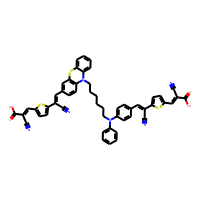
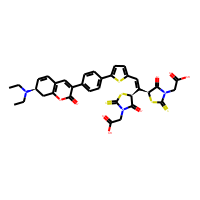
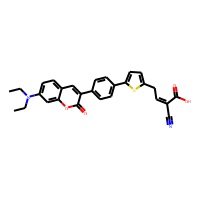
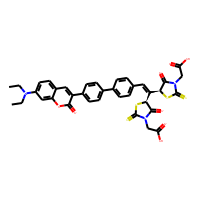
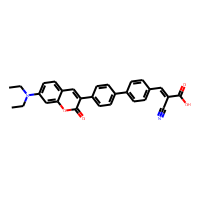
...
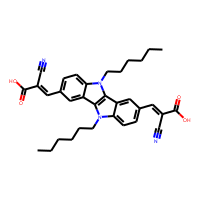
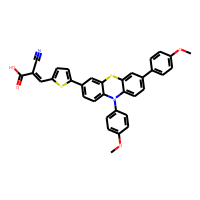
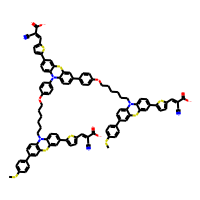
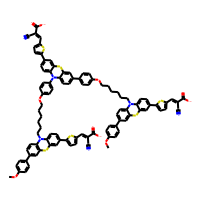
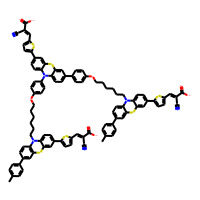

In [6]:
from rdkit import Chem
from rdkit.Chem import PandasTools
from rdkit.Chem import AllChem
from rdkit.Chem import Draw
from rdkit.Chem.Draw import IPythonConsole
IPythonConsole.ipython_useSVG=True
# from mols2grid import display as dp

PandasTools.AddMoleculeColumnToFrame(globalDf, 'Molecule SMILE', 'Molecule', includeFingerprints=True)
globalDf

,Molecule SMILE,Molecule keywords,Molecule spectrum absorption maxima,Molecule spectrum emission maxima,Molecule spectrum solvent,VOC,JSC,FF,PCE,Molecule
0,N#C/C(=C\c1ccc(cc1)N(c1ccccc1)CCCCCCN1c2ccccc2...,phenothiazine,439.0,576.0,CH2Cl2/MeOH (1:1),687.0,10.79,0.7000,5.19,
10,CCN([C@@H]1C=Cc2c(C1)oc(=O)c(c2)c1ccc(cc1)c1cc...,coumarin,465.0,490.0,Acetonitrile-DMSO,560.0,3.41,0.7300,1.39,
11,CCN(c1ccc2c(c1)oc(=O)c(c2)c1ccc(cc1)c1ccc(s1)C...,coumarin,438.0,500.0,Acetonitrile-DMSO,660.0,7.72,0.7100,3.62,
12,CCN(c1ccc2c(c1)oc(=O)c(c2)c1ccc(cc1)c1ccc(cc1)...,coumarin,425.0,487.0,Acetonitrile-DMSO,600.0,4.03,0.7300,1.77,
13,CCN(c1ccc2c(c1)oc(=O)c(c2)c1ccc(cc1)c1ccc(cc1)...,coumarin,413.0,490.0,Acetonitrile-DMSO,690.0,5.79,0.7000,2.80,
14,CCN(c1ccc2c(c1)oc(=O)c(c2)c1ccc(cc1)/C=C(\[C@H...,coumarin,449.0,494.0,Acetonitrile-DMSO,580.0,3.33,0.7300,1.41,
16,OC(=O)C[n+]1c(/C=C/c2cc3cc4c5c(c3oc2=O)C(C)(C)...,coumarin,578.0,673.0,"methanol, tert-butyl alcohol-acetonitrile",380.0,4.50,0.6300,1.10,
17,OC(=O)c1ccc2c(c1)C(C)(C)C(=[N+]2C)/C=C/c1cc2cc...,coumarin,616.0,490.0,"methanol, tert-butyl alcohol-acetonitrile",340.0,2.70,0.6300,0.60,
18,OC(=O)CN1C(=S)S/C(=C/c2cc3cc4c5c(c3oc2=O)C(C)(...,coumarin,539.0,580.0,"methanol, tert-butyl alcohol-acetonitrile",490.0,7.50,0.7000,2.60,
19,OC(=O)C(=C/C=C/c1cc2cc3c4c(c2oc1=O)C(C)(C)CCN4...,coumarin,506.0,610.0,"methanol, tert-butyl alcohol-acetonitrile",480.0,12.80,0.6000,3.70,

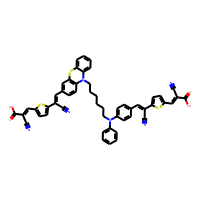
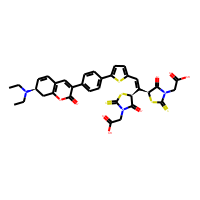
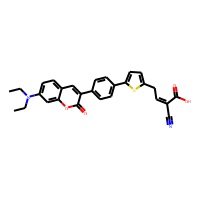
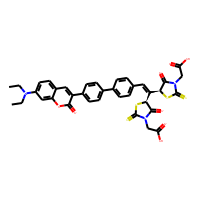
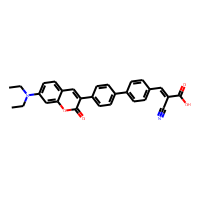
...
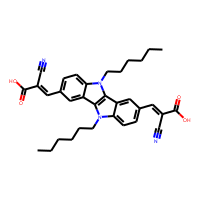
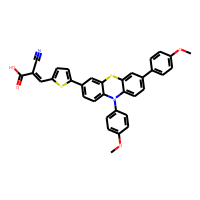
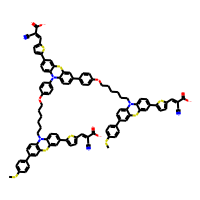
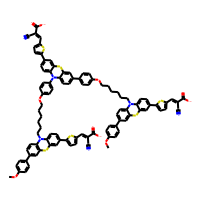
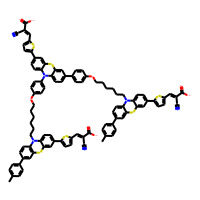

In [7]:
globalDf

In [8]:
cols = list(globalDf.columns)
globalDf = globalDf[cols[9:] + cols[0:9]]


In [21]:
globalDf.to_csv('globalDataWMol.csv')

In [9]:
dsscData= pd.read_csv('globalDataWMol.csv', index_col=0)

,Molecule,Molecule SMILE,Molecule keywords,VOC,JSC,FF,PCE
0,,N#C/C(=C\c1ccc(cc1)N(c1ccccc1)CCCCCCN1c2ccccc2...,phenothiazine,687.0,10.79,0.7000,5.19
10,,CCN([C@@H]1C=Cc2c(C1)oc(=O)c(c2)c1ccc(cc1)c1cc...,coumarin,560.0,3.41,0.7300,1.39
11,,CCN(c1ccc2c(c1)oc(=O)c(c2)c1ccc(cc1)c1ccc(s1)C...,coumarin,660.0,7.72,0.7100,3.62
12,,CCN(c1ccc2c(c1)oc(=O)c(c2)c1ccc(cc1)c1ccc(cc1)...,coumarin,600.0,4.03,0.7300,1.77
13,,CCN(c1ccc2c(c1)oc(=O)c(c2)c1ccc(cc1)c1ccc(cc1)...,coumarin,690.0,5.79,0.7000,2.80
14,,CCN(c1ccc2c(c1)oc(=O)c(c2)c1ccc(cc1)/C=C(\[C@H...,coumarin,580.0,3.33,0.7300,1.41
16,,OC(=O)C[n+]1c(/C=C/c2cc3cc4c5c(c3oc2=O)C(C)(C)...,coumarin,380.0,4.50,0.6300,1.10
17,,OC(=O)c1ccc2c(c1)C(C)(C)C(=[N+]2C)/C=C/c1cc2cc...,coumarin,340.0,2.70,0.6300,0.60
18,,OC(=O)CN1C(=S)S/C(=C/c2cc3cc4c5c(c3oc2=O)C(C)(...,coumarin,490.0,7.50,0.7000,2.60
19,,OC(=O)C(=C/C=C/c1cc2cc3c4c(c2oc1=O)C(C)(C)CCN4...,coumarin,480.0,12.80,0.6000,3.70

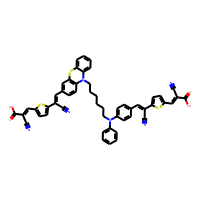
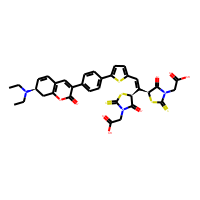
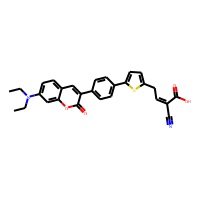
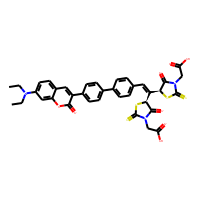
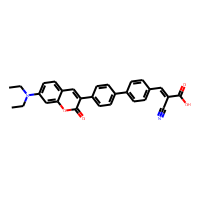
...
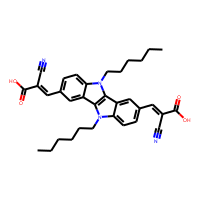
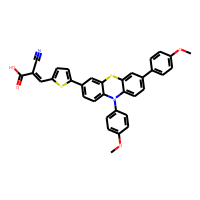
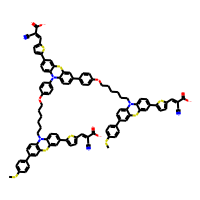
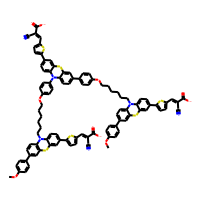
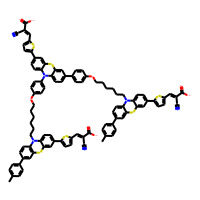

In [10]:
cols = list(dsscData.columns)
dsscData = dsscData.drop(columns=cols[3:6])
dsscData

In [12]:
dsscData.to_csv('trimmedGlobalData.csv')

mols2grid.display(dsscData, smiles_col = 'Molecule SMILE', size=(250, 250), subset=["img", "PCE", "Molecule keywords"])

C:\Users\Paul\Anaconda3\lib\site-packages\mols2grid\select.py:24: UserWarning: Overwriting non-empty 'default' grid selection: {556: ''}
  f"Overwriting non-empty {name!r} grid selection: {str(overwrite)}"


In [14]:
# PaDELPy Descriptors
# Set-up
from padelpy import from_smiles

descriptors = from_smiles('CCC')
print(descriptors)

ModuleNotFoundError: No module named 'padelpy'

In [8]:
!pip3 freeze

astroid==2.4.2
asttokens==2.0.5
backcall==0.2.0
black==22.1.0
certifi==2020.12.5
chardet==4.0.0
click==8.0.3
click-default-group==1.2.2
cloup==0.7.1
colorama==0.4.4
colour==0.1.5
commonmark==0.9.1
cycler==0.10.0
dash==1.9.1
dash-core-components==1.8.1
dash-html-components==1.0.2
dash-renderer==1.2.4
dash-table==4.6.1
debugpy==1.5.1
decorator==5.0.9
dnspython==1.16.0
executing==0.8.2
Flask==1.1.1
Flask-Compress==1.4.0
future==0.18.2
glcontext==2.3.3
idna==2.10
ipykernel==6.9.0
ipython==8.0.1
ipython-genutils==0.2.0
isort==5.6.4
itsdangerous==1.1.0
jedi==0.17.2
Jinja2==3.0.3
joblib==1.1.0
jupyter-client==6.1.7
jupyter-core==4.6.3
kiwisolver==1.3.1
lazy-object-proxy==1.4.3
manim==0.7.0
ManimPango==0.3.0
mapbox-earcut==0.12.10
MarkupSafe==2.0.1
matplotlib==3.3.3
matplotlib-inline==0.1.3
mccabe==0.6.1
moderngl==5.6.4
moderngl-window==2.3.0
mols2grid==0.1.0
mpld3==0.5.7
multipledispatch==0.6.0
mypy-extensions==0.4.3
nest-asyncio==1.5.4
networkx==2.5
numpy==1.19.5
padelpy==0.1.11
pandas==1.2.